# Classification of Shoes.

In [1]:
import tensorflow as tf
tf.test.is_built_with_cuda()

True

In [2]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 834040245801287667
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 2241331200
locality {
  bus_id: 1
  links {
  }
}
incarnation: 9804833615565314308
physical_device_desc: "device: 0, name: NVIDIA GeForce GTX 1650, pci bus id: 0000:01:00.0, compute capability: 7.5"
xla_global_id: 416903419
]


In [3]:
# import the necessary packages
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Activation
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.utils import to_categorical

from sklearn.model_selection import train_test_split

from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import argparse
import random
import cv2
import os
import imutils

import warnings
from tqdm import tqdm
import itertools

warnings.filterwarnings("ignore")
SEED = 42   # set random seed

In [4]:
#run only one time then comment everything

# import patoolib
# patoolib.extract_archive('165890546209560ec2379f8793842aa5b168a_.zip')

In [5]:
model=Sequential()
model.add(Conv2D(20, (5, 5), padding='same', input_shape=(24,24,3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2,2), strides=(2,2)))
model.add(Flatten())
model.add(Dense(500))
model.add(Activation('relu'))
# Softmax Classifier
model.add(Dense(3))
model.add(Activation('softmax'))

In [6]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 24, 24, 20)        1520      
                                                                 
 activation (Activation)     (None, 24, 24, 20)        0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 12, 12, 20)       0         
 )                                                               
                                                                 
 flatten (Flatten)           (None, 2880)              0         
                                                                 
 dense (Dense)               (None, 500)               1440500   
                                                                 
 activation_1 (Activation)   (None, 500)               0         
                                                        

In [7]:
# create CNN Model
class LeNet:

    @staticmethod
    def build(width, height, depth, classes):
        # initialize the model
        model = Sequential()
        inputShape = (height, width, depth) # (h, h, chanel)

        # if we are using "channels first", update the input shape
        if K.image_data_format() == "channels_first":
            inputShape = (depth, height, width)

        # first set of CONV => RELU => POOL layers
        model.add(Conv2D(20, (5, 5), padding="same",input_shape=inputShape))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # second set of CONV => RELU => POOL layers
        model.add(Conv2D(50, (5, 5), padding="same"))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # third set of CONV => RELU => POOL layers
        model.add(Conv2D(100, (5, 5), padding="same"))
        model.add(Activation("relu"))
        model.add(MaxPooling2D(pool_size=(2, 2), strides=(2, 2)))

        # first (and only) set of FC => RELU layers
        model.add(Flatten())
        model.add(Dense(500))
        model.add(Activation("relu"))

        # softmax classifier
        model.add(Dense(classes))
        model.add(Activation("softmax"))

        # return the constructed network architecture
        return model

In [8]:
DATASET='train' #this fold must contain three subfolder with images
MODEL='boot.model' #name to store the model on disk
PLOT='plot.png' #plot name

In [9]:
EPOCHS=25
INIT_LR=1e-3
BS=32

In [10]:
# import os
os.chdir("E:\Imarticus Learning\PGA14_Deep Learning\DL_Exam\PGA Wkend DL Exam\Datasets\CNN\Shoe Classification")

In [11]:
# Listing the directories.
!dir

 Volume in drive E is New Volume
 Volume Serial Number is 1E96-7968

 Directory of E:\Imarticus Learning\PGA14_Deep Learning\DL_Exam\PGA Wkend DL Exam\Datasets\CNN\Shoe Classification

08-04-2023  14:33    <DIR>          .
27-07-2022  10:57    <DIR>          ..
08-04-2023  14:33    <DIR>          flagged
27-07-2022  10:57    <DIR>          test
27-07-2022  10:57    <DIR>          train
               0 File(s)              0 bytes
               5 Dir(s)  315,582,361,600 bytes free


In [12]:
# initialize the data & labels
print('[INFO] loading images...')
data=[]
labels=[]

#grab the image paths and randomly shuffle them
imagePaths=sorted(list(paths.list_images(DATASET)))
random.seed(42)
random.shuffle(imagePaths)

# progress bar
with tqdm(total=len(imagePaths)) as pbar:

    #loop over the input images
    for idx, imagePath in enumerate(imagePaths):
        #load the image, pre-process it, and store it in the data list
        image=cv2.imread(imagePath)
        image=cv2.resize(image, (28,28))
        image=img_to_array(image)
        data.append(image)

        #extract the class label from the image path and update labels list
        label=imagePath.split(os.path.sep)[-2]

        if label=='Boots':
            label=0
        elif label=='Sandals':
            label=1
        elif label=='Slippers':
            label=2

        labels.append(label)
        #update the progressbar
        pbar.update(1)

[INFO] loading images...


100%|███████████████████████████████████████████████████████████████████████████████| 778/778 [00:04<00:00, 168.99it/s]


In [13]:
data=np.array(data, dtype='float')/255.0
labels=np.array(labels)

In [14]:
(trainX, testX, trainY, testY)=train_test_split(data, labels, test_size=0.25, random_state=42)

In [15]:
trainX.shape

(583, 28, 28, 3)

In [16]:
trainY.shape

(583,)

In [17]:
testY.shape

(195,)

In [18]:
trainY.shape

(583,)

In [19]:
trainY = to_categorical(trainY, num_classes=3)
testY = to_categorical(testY, num_classes=3)

In [20]:
trainY[0]

array([1., 0., 0.], dtype=float32)

 ### Datapreprocessing Augumentation

In [37]:
# construct the image generator for data augmentation
aug=ImageDataGenerator(rotation_range=30,
                       width_shift_range=0.1,
                       height_shift_range=0.1,
                       shear_range=0.2,
                       zoom_range=0.2,
                       horizontal_flip=True,
                       fill_mode='nearest')

In [38]:
# initialize the model
print('[INFO] compiling model...')
model=LeNet.build(width=28, height=28, depth=3, classes=3)

opt=Adam(lr=INIT_LR)

model.compile(loss='categorical_crossentropy', optimizer=opt, metrics=['accuracy'])

print('[INFO] compiling compiled...')
EPOCHS=300
INIT_LR=1e-3
BS=32

[INFO] compiling model...
[INFO] compiling compiled...


In [39]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 28, 28, 20)        1520      
                                                                 
 activation_13 (Activation)  (None, 28, 28, 20)        0         
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 14, 14, 20)       0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 14, 14, 50)        25050     
                                                                 
 activation_14 (Activation)  (None, 14, 14, 50)        0         
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 7, 7, 50)         0         
 2D)                                                  

In [40]:
# train the network
print('[INFO] training network...')
H=model.fit(x=aug.flow(trainX, trainY, batch_size=BS),
            validation_data=(testX, testY),
            steps_per_epoch=len(trainX)//BS,
            epochs=EPOCHS,
            verbose=1)

[INFO] training network...
Epoch 1/300
18/18 [==============================] - 1s 23ms/step - loss: 1.0409 - accuracy: 0.4574 - val_loss: 0.8961 - val_accuracy: 0.7077
Epoch 2/300
18/18 [==============================] - 0s 15ms/step - loss: 0.8054 - accuracy: 0.6372 - val_loss: 0.5340 - val_accuracy: 0.7385
Epoch 3/300
18/18 [==============================] - 0s 14ms/step - loss: 0.7137 - accuracy: 0.6497 - val_loss: 0.5232 - val_accuracy: 0.7487
Epoch 4/300
18/18 [==============================] - 0s 14ms/step - loss: 0.6468 - accuracy: 0.6951 - val_loss: 0.4897 - val_accuracy: 0.8205
Epoch 5/300
18/18 [==============================] - 0s 15ms/step - loss: 0.6403 - accuracy: 0.7132 - val_loss: 0.4380 - val_accuracy: 0.7846
Epoch 6/300
18/18 [==============================] - 0s 14ms/step - loss: 0.5346 - accuracy: 0.7552 - val_loss: 0.3648 - val_accuracy: 0.8564
Epoch 7/300
18/18 [==============================] - 0s 15ms/step - loss: 0.4642 - accuracy: 0.8040 - val_loss: 0.3852 - 

18/18 [==============================] - 0s 14ms/step - loss: 0.2675 - accuracy: 0.8911 - val_loss: 0.1816 - val_accuracy: 0.9282
Epoch 59/300
18/18 [==============================] - 0s 15ms/step - loss: 0.2487 - accuracy: 0.9201 - val_loss: 0.3095 - val_accuracy: 0.8821
Epoch 60/300
18/18 [==============================] - 0s 14ms/step - loss: 0.2201 - accuracy: 0.9056 - val_loss: 0.2347 - val_accuracy: 0.8821
Epoch 61/300
18/18 [==============================] - 0s 14ms/step - loss: 0.2716 - accuracy: 0.9002 - val_loss: 0.2006 - val_accuracy: 0.9179
Epoch 62/300
18/18 [==============================] - 0s 15ms/step - loss: 0.1893 - accuracy: 0.9347 - val_loss: 0.1691 - val_accuracy: 0.9385
Epoch 63/300
18/18 [==============================] - 0s 15ms/step - loss: 0.2254 - accuracy: 0.9111 - val_loss: 0.2831 - val_accuracy: 0.8872
Epoch 64/300
18/18 [==============================] - 0s 16ms/step - loss: 0.2076 - accuracy: 0.9292 - val_loss: 0.1531 - val_accuracy: 0.9385
Epoch 65/300

18/18 [==============================] - 0s 17ms/step - loss: 0.1157 - accuracy: 0.9564 - val_loss: 0.1234 - val_accuracy: 0.9487
Epoch 116/300
18/18 [==============================] - 0s 20ms/step - loss: 0.1150 - accuracy: 0.9564 - val_loss: 0.1997 - val_accuracy: 0.9282
Epoch 117/300
18/18 [==============================] - 0s 18ms/step - loss: 0.1045 - accuracy: 0.9583 - val_loss: 0.1838 - val_accuracy: 0.9333
Epoch 118/300
18/18 [==============================] - 0s 14ms/step - loss: 0.1378 - accuracy: 0.9474 - val_loss: 0.1706 - val_accuracy: 0.9385
Epoch 119/300
18/18 [==============================] - 0s 14ms/step - loss: 0.1226 - accuracy: 0.9583 - val_loss: 0.1501 - val_accuracy: 0.9385
Epoch 120/300
18/18 [==============================] - 0s 17ms/step - loss: 0.1028 - accuracy: 0.9601 - val_loss: 0.1580 - val_accuracy: 0.9282
Epoch 121/300
18/18 [==============================] - 0s 15ms/step - loss: 0.1007 - accuracy: 0.9619 - val_loss: 0.1286 - val_accuracy: 0.9385
Epoch 

Epoch 172/300
18/18 [==============================] - 0s 22ms/step - loss: 0.1228 - accuracy: 0.9528 - val_loss: 0.1717 - val_accuracy: 0.9385
Epoch 173/300
18/18 [==============================] - 0s 17ms/step - loss: 0.1956 - accuracy: 0.9419 - val_loss: 0.3134 - val_accuracy: 0.9128
Epoch 174/300
18/18 [==============================] - 0s 16ms/step - loss: 0.1242 - accuracy: 0.9546 - val_loss: 0.2469 - val_accuracy: 0.9128
Epoch 175/300
18/18 [==============================] - 0s 16ms/step - loss: 0.1114 - accuracy: 0.9618 - val_loss: 0.1609 - val_accuracy: 0.9282
Epoch 176/300
18/18 [==============================] - 0s 17ms/step - loss: 0.0796 - accuracy: 0.9800 - val_loss: 0.2283 - val_accuracy: 0.9282
Epoch 177/300
18/18 [==============================] - 0s 20ms/step - loss: 0.1043 - accuracy: 0.9528 - val_loss: 0.3452 - val_accuracy: 0.8513
Epoch 178/300
18/18 [==============================] - 0s 17ms/step - loss: 0.0881 - accuracy: 0.9710 - val_loss: 0.1556 - val_accuracy:

Epoch 229/300
18/18 [==============================] - 0s 15ms/step - loss: 0.0543 - accuracy: 0.9855 - val_loss: 0.1435 - val_accuracy: 0.9590
Epoch 230/300
18/18 [==============================] - 0s 14ms/step - loss: 0.0985 - accuracy: 0.9619 - val_loss: 0.1599 - val_accuracy: 0.9487
Epoch 231/300
18/18 [==============================] - 0s 14ms/step - loss: 0.0864 - accuracy: 0.9619 - val_loss: 0.1248 - val_accuracy: 0.9487
Epoch 232/300
18/18 [==============================] - 0s 14ms/step - loss: 0.0844 - accuracy: 0.9728 - val_loss: 0.2265 - val_accuracy: 0.9231
Epoch 233/300
18/18 [==============================] - 0s 14ms/step - loss: 0.0662 - accuracy: 0.9746 - val_loss: 0.1231 - val_accuracy: 0.9641
Epoch 234/300
18/18 [==============================] - 0s 15ms/step - loss: 0.0489 - accuracy: 0.9855 - val_loss: 0.1906 - val_accuracy: 0.9385
Epoch 235/300
18/18 [==============================] - 0s 15ms/step - loss: 0.0934 - accuracy: 0.9637 - val_loss: 0.1702 - val_accuracy:

Epoch 286/300
18/18 [==============================] - 0s 17ms/step - loss: 0.0479 - accuracy: 0.9855 - val_loss: 0.1627 - val_accuracy: 0.9538
Epoch 287/300
18/18 [==============================] - 0s 18ms/step - loss: 0.0435 - accuracy: 0.9837 - val_loss: 0.1588 - val_accuracy: 0.9590
Epoch 288/300
18/18 [==============================] - 0s 20ms/step - loss: 0.0755 - accuracy: 0.9746 - val_loss: 0.2388 - val_accuracy: 0.9385
Epoch 289/300
18/18 [==============================] - 0s 21ms/step - loss: 0.0810 - accuracy: 0.9673 - val_loss: 0.2140 - val_accuracy: 0.9385
Epoch 290/300
18/18 [==============================] - 0s 17ms/step - loss: 0.0449 - accuracy: 0.9909 - val_loss: 0.0684 - val_accuracy: 0.9795
Epoch 291/300
18/18 [==============================] - 0s 14ms/step - loss: 0.0893 - accuracy: 0.9710 - val_loss: 0.1190 - val_accuracy: 0.9692
Epoch 292/300
18/18 [==============================] - 0s 15ms/step - loss: 0.0637 - accuracy: 0.9728 - val_loss: 0.0800 - val_accuracy:

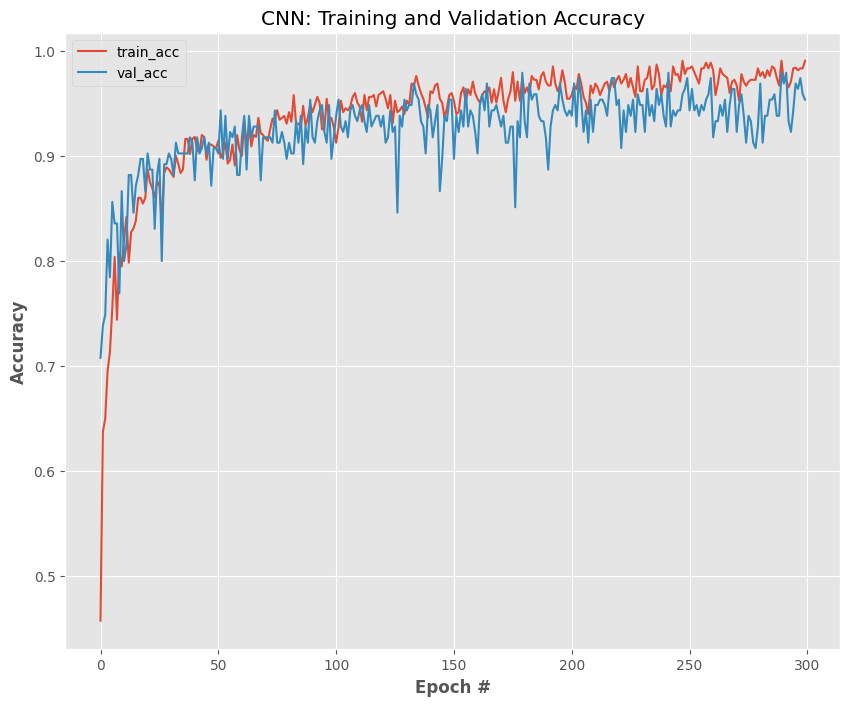

In [43]:
# plot the training and validation accuracy
N = np.arange(0, 300)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["accuracy"], label="train_acc")
plt.plot(N, H.history["val_accuracy"], label="val_acc")
plt.title("CNN: Training and Validation Accuracy")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Accuracy", weight="bold")
plt.legend()
plt.show()

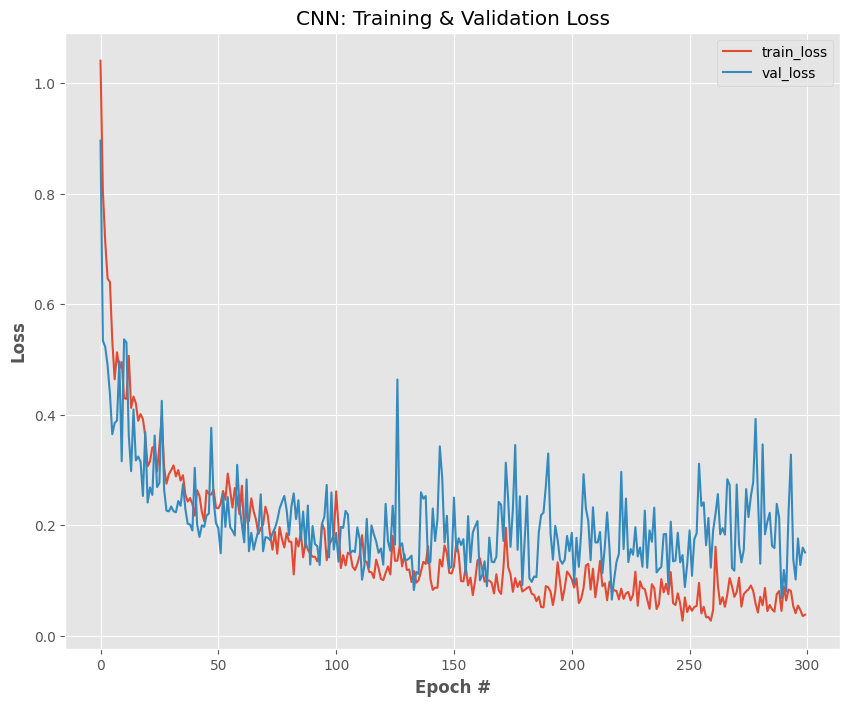

In [44]:
# plot the training and validation loss
N = np.arange(0, 300)
plt.style.use("ggplot")
plt.figure(figsize = [10,8])
plt.plot(N, H.history["loss"], label="train_loss")
plt.plot(N, H.history["val_loss"], label="val_loss")
plt.title("CNN: Training & Validation Loss")
plt.xlabel("Epoch #", weight="bold")
plt.ylabel("Loss", weight="bold")
plt.legend()
plt.show()

In [45]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    #plt.grid(b=None)
    ax = fig.add_subplot(111)

    ax.imshow(img)

[INFO] loading network and...


  0%|                                                                                           | 0/89 [00:00<?, ?it/s]

1/1 [==============================] - 0s 74ms/step


  1%|▉                                                                                  | 1/89 [00:00<00:11,  7.52it/s]

1/1 [==============================] - 0s 22ms/step


  3%|██▊                                                                                | 3/89 [00:00<00:08, 10.57it/s]

1/1 [==============================] - 0s 21ms/step


  6%|████▋                                                                              | 5/89 [00:00<00:06, 12.03it/s]

1/1 [==============================] - 0s 21ms/step


  8%|██████▌                                                                            | 7/89 [00:00<00:06, 12.32it/s]

1/1 [==============================] - 0s 28ms/step


 10%|████████▍                                                                          | 9/89 [00:00<00:06, 11.87it/s]

1/1 [==============================] - 0s 21ms/step


 12%|██████████▏                                                                       | 11/89 [00:00<00:06, 11.96it/s]

1/1 [==============================] - 0s 22ms/step


 15%|███████████▉                                                                      | 13/89 [00:01<00:06, 12.48it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█████████████▊                                                                    | 15/89 [00:01<00:05, 12.87it/s]

1/1 [==============================] - 0s 27ms/step


 19%|███████████████▋                                                                  | 17/89 [00:01<00:05, 12.27it/s]

1/1 [==============================] - 0s 23ms/step


 21%|█████████████████▌                                                                | 19/89 [00:01<00:05, 12.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|███████████████████▎                                                              | 21/89 [00:01<00:05, 12.56it/s]

1/1 [==============================] - 0s 27ms/step


 26%|█████████████████████▏                                                            | 23/89 [00:01<00:05, 12.54it/s]

1/1 [==============================] - 0s 21ms/step


 28%|███████████████████████                                                           | 25/89 [00:02<00:05, 12.33it/s]

1/1 [==============================] - 0s 22ms/step


 30%|████████████████████████▉                                                         | 27/89 [00:02<00:04, 12.72it/s]

1/1 [==============================] - 0s 22ms/step


 33%|██████████████████████████▋                                                       | 29/89 [00:02<00:04, 12.68it/s]

1/1 [==============================] - 0s 23ms/step


 35%|████████████████████████████▌                                                     | 31/89 [00:02<00:05, 10.95it/s]

1/1 [==============================] - 0s 33ms/step


 37%|██████████████████████████████▍                                                   | 33/89 [00:03<00:10,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 39%|████████████████████████████████▏                                                 | 35/89 [00:03<00:08,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


 42%|██████████████████████████████████                                                | 37/89 [00:03<00:06,  7.53it/s]

1/1 [==============================] - 0s 23ms/step


 44%|███████████████████████████████████▉                                              | 39/89 [00:03<00:05,  8.75it/s]

1/1 [==============================] - 0s 23ms/step


 46%|█████████████████████████████████████▊                                            | 41/89 [00:04<00:04,  9.81it/s]

1/1 [==============================] - 0s 23ms/step


 48%|███████████████████████████████████████▌                                          | 43/89 [00:04<00:04, 10.75it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████████████████████████████████████████▍                                        | 45/89 [00:04<00:03, 11.62it/s]

1/1 [==============================] - 0s 21ms/step


 53%|███████████████████████████████████████████▎                                      | 47/89 [00:04<00:03, 12.26it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████████████████████████████████████████████▏                                    | 49/89 [00:04<00:03, 12.59it/s]

1/1 [==============================] - 0s 23ms/step


 57%|██████████████████████████████████████████████▉                                   | 51/89 [00:04<00:02, 13.09it/s]

1/1 [==============================] - 0s 20ms/step


 60%|████████████████████████████████████████████████▊                                 | 53/89 [00:04<00:02, 13.63it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████████████████████████████████████████████████▋                               | 55/89 [00:05<00:02, 13.77it/s]

1/1 [==============================] - 0s 22ms/step


 64%|████████████████████████████████████████████████████▌                             | 57/89 [00:05<00:02, 13.88it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████████████████████████████████████████████████████▎                           | 59/89 [00:05<00:02, 13.72it/s]

1/1 [==============================] - 0s 23ms/step


 69%|████████████████████████████████████████████████████████▏                         | 61/89 [00:05<00:02, 13.84it/s]

1/1 [==============================] - 0s 24ms/step


 71%|██████████████████████████████████████████████████████████                        | 63/89 [00:05<00:01, 13.72it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████████████████████████████████████████████████████████▉                      | 65/89 [00:05<00:01, 13.74it/s]

1/1 [==============================] - 0s 23ms/step


 75%|█████████████████████████████████████████████████████████████▋                    | 67/89 [00:05<00:01, 13.67it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████████████████████████████████████████████████████████████▌                  | 69/89 [00:06<00:01, 13.57it/s]

1/1 [==============================] - 0s 23ms/step


 80%|█████████████████████████████████████████████████████████████████▍                | 71/89 [00:06<00:01, 13.47it/s]

1/1 [==============================] - 0s 24ms/step


 82%|███████████████████████████████████████████████████████████████████▎              | 73/89 [00:06<00:01, 13.09it/s]

1/1 [==============================] - 0s 33ms/step


 84%|█████████████████████████████████████████████████████████████████████             | 75/89 [00:06<00:01, 12.17it/s]

1/1 [==============================] - 0s 30ms/step


 87%|██████████████████████████████████████████████████████████████████████▉           | 77/89 [00:06<00:01, 11.87it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████████████████████████████████████████████████████████████████████▊         | 79/89 [00:06<00:00, 11.72it/s]

1/1 [==============================] - 0s 26ms/step


 91%|██████████████████████████████████████████████████████████████████████████▋       | 81/89 [00:07<00:00, 12.10it/s]

1/1 [==============================] - 0s 26ms/step


 93%|████████████████████████████████████████████████████████████████████████████▍     | 83/89 [00:07<00:00, 12.25it/s]

1/1 [==============================] - 0s 23ms/step


 96%|██████████████████████████████████████████████████████████████████████████████▎   | 85/89 [00:07<00:00, 12.47it/s]

1/1 [==============================] - 0s 21ms/step


 98%|████████████████████████████████████████████████████████████████████████████████▏ | 87/89 [00:07<00:00, 12.87it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████████████████████████████████████████████████████████████████████████████| 89/89 [00:07<00:00, 11.60it/s]


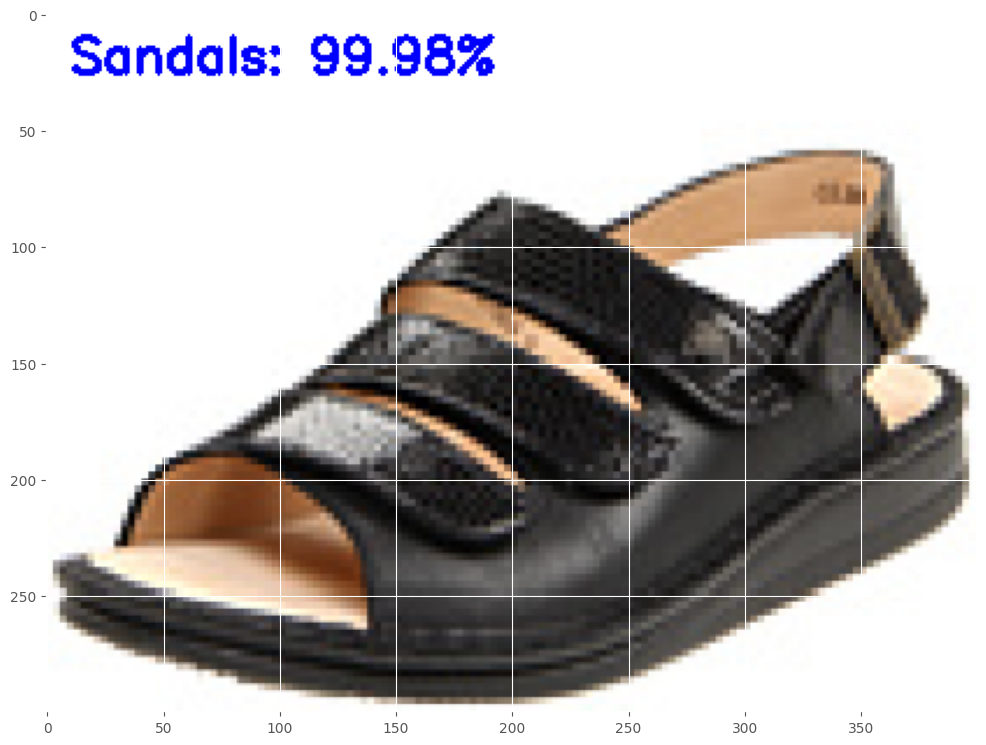

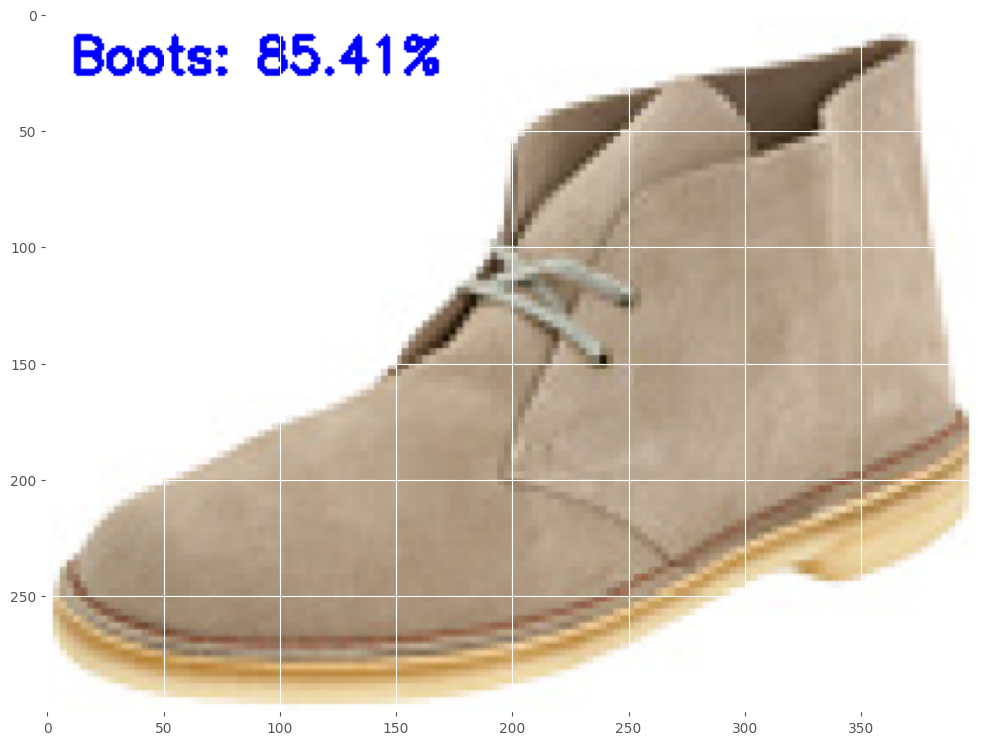

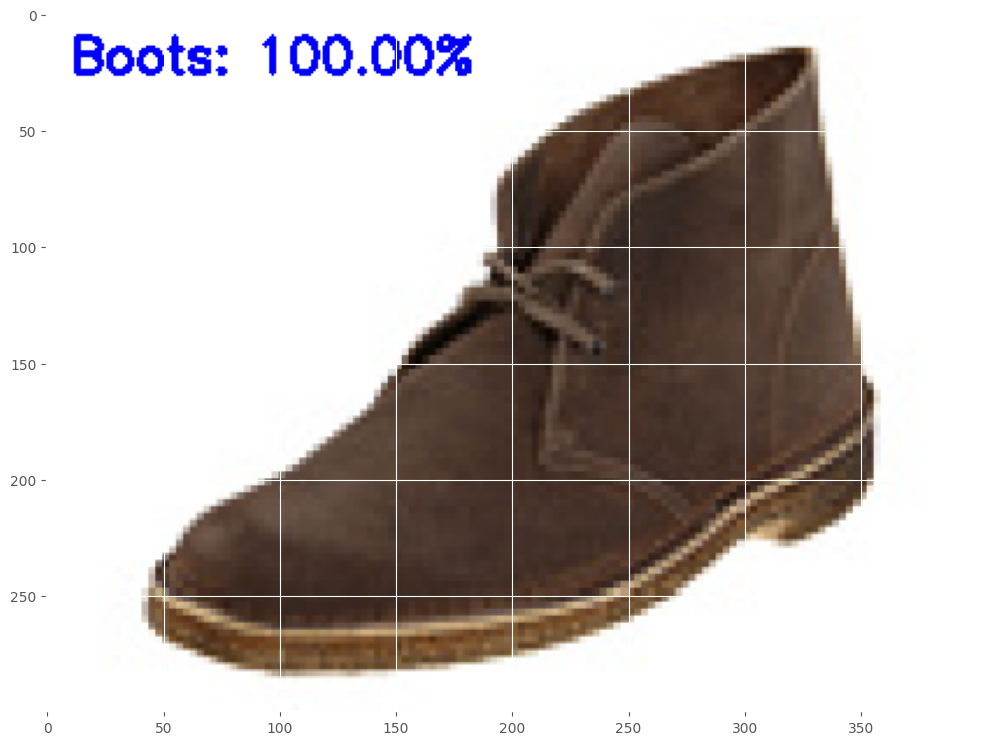

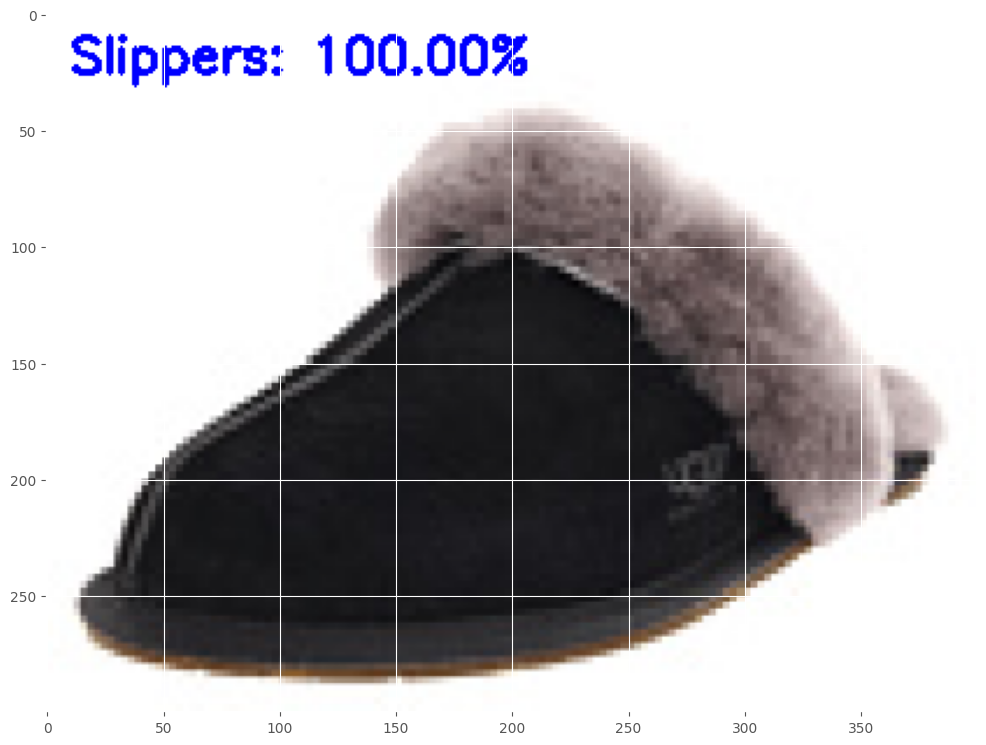

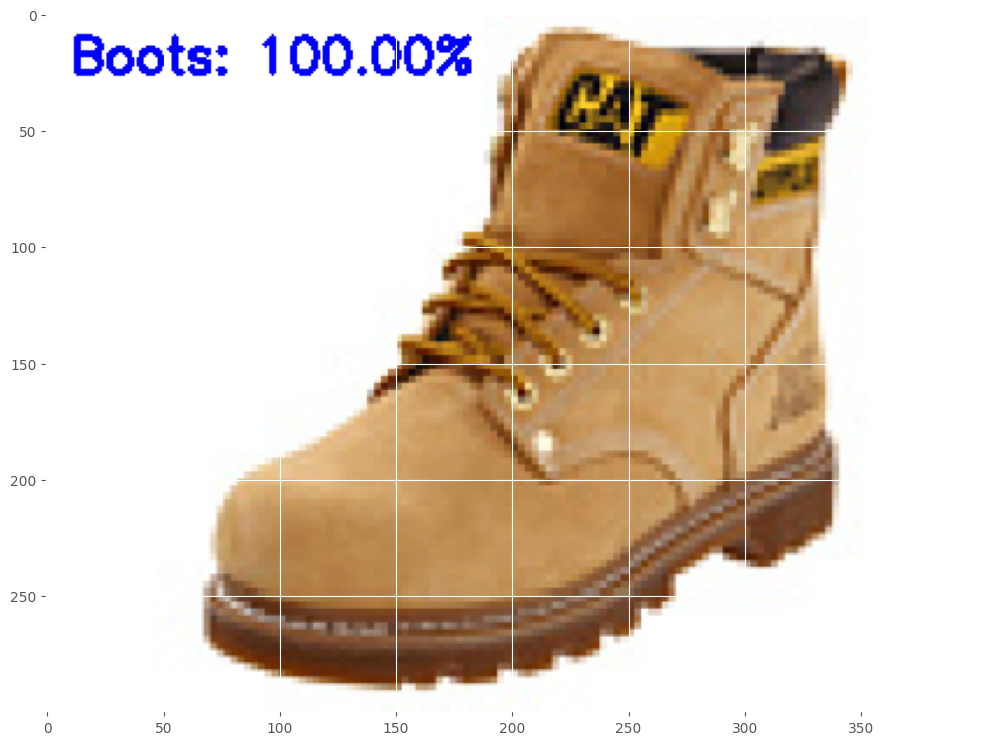

...

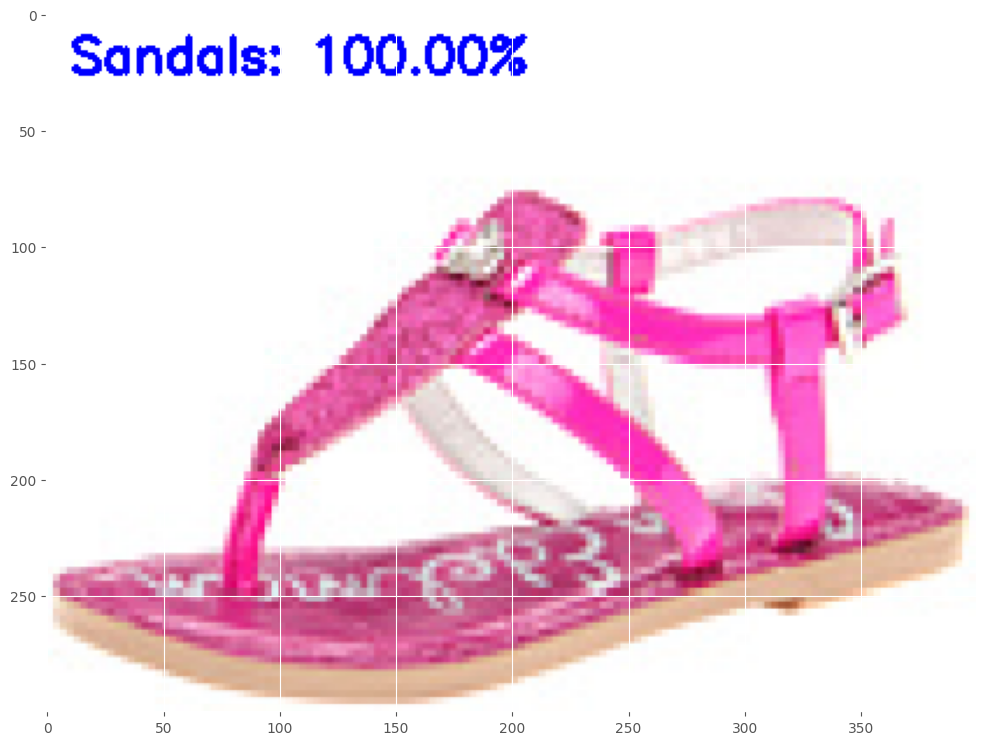

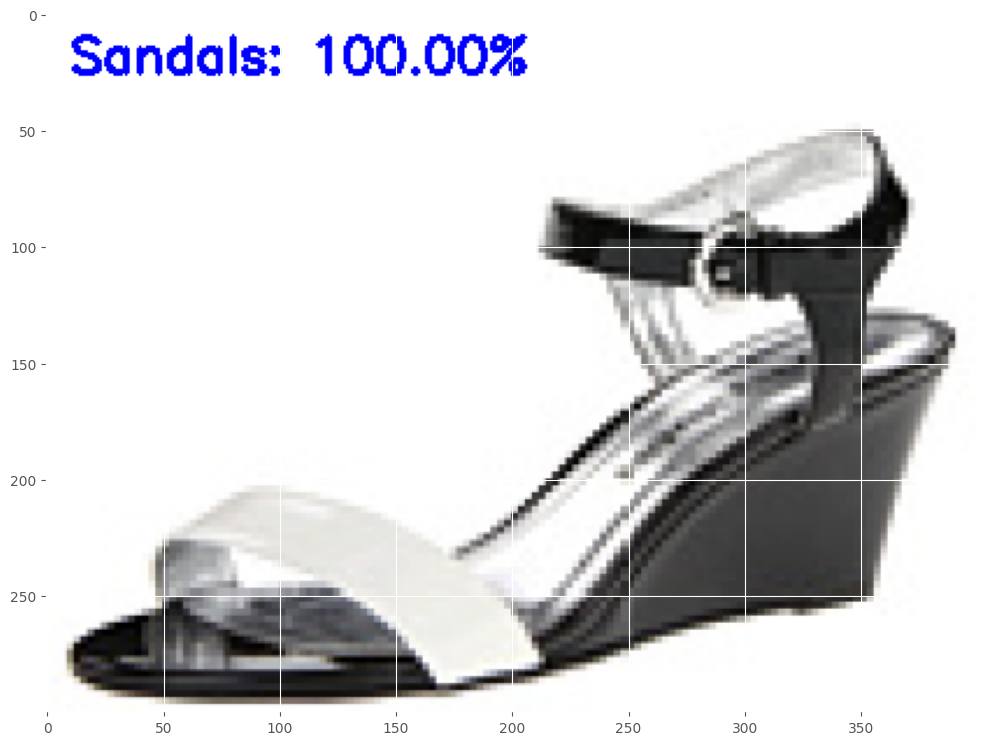

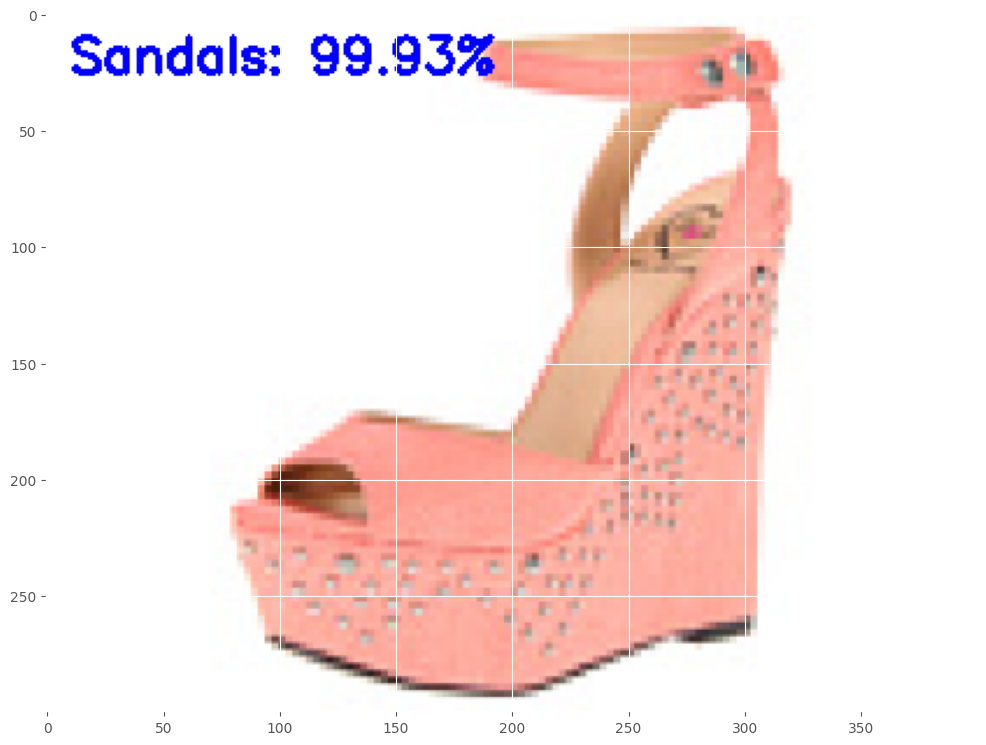

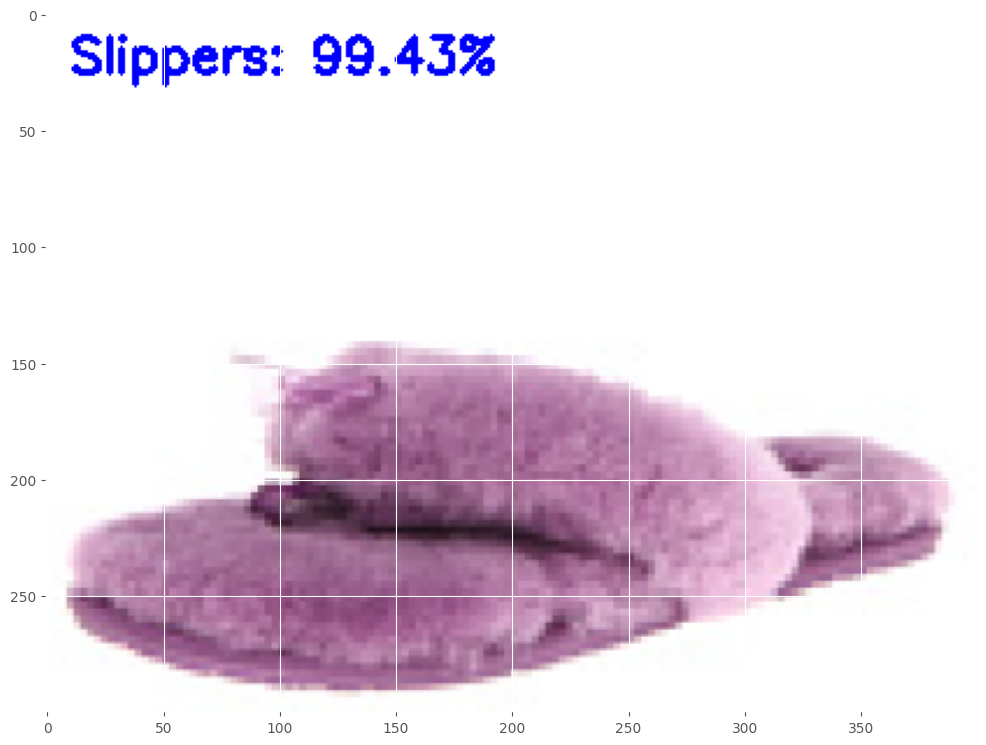

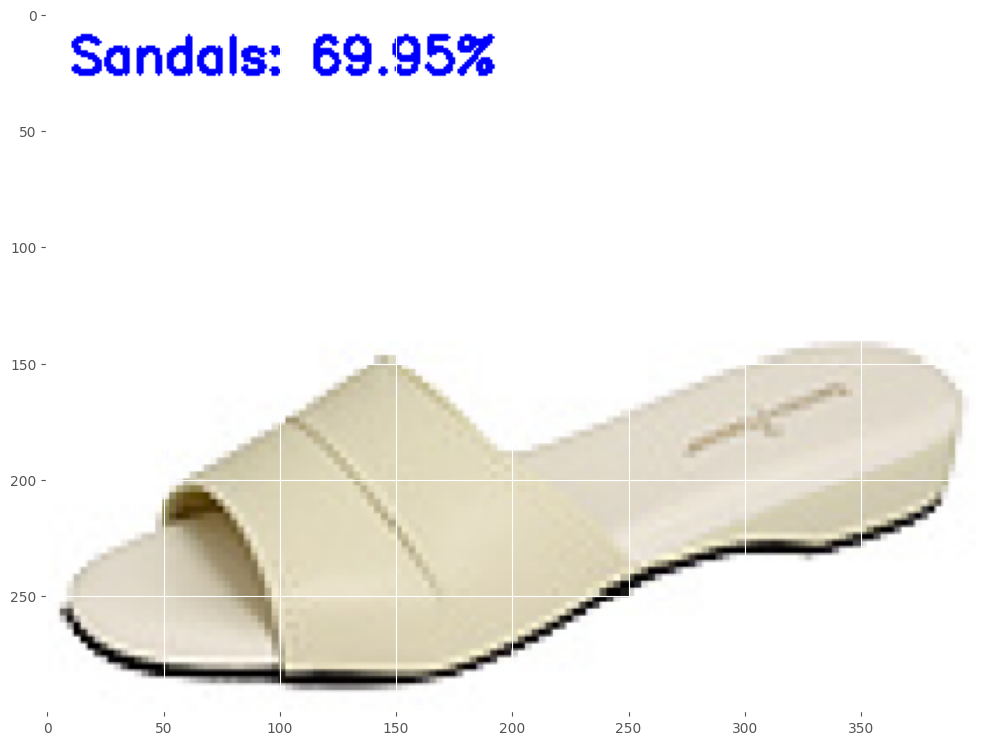

In [46]:
# import the necessary packages
from tensorflow.keras.models import load_model
import pickle
import cv2

# # load the model 
print("[INFO] loading network and...")
# model = load_model(MODEL)

# grab the image paths and randomly shuffle themt
testImagePaths = sorted(list(paths.list_images('test')))   # data folder with 2 categorical folders

all_class = ["Boots", "Sandals", "Slippers"]


# progress bar 
with tqdm(total=len(testImagePaths)) as pbar:
    
    for imagePath in testImagePaths:
        
        # load the image
        image = cv2.imread(imagePath)
        orig = image.copy()

        # pre-process the image for classification
        image = cv2.resize(image, (28, 28))
        image = image.astype("float") / 255.0
        image = img_to_array(image)
        image = np.expand_dims(image, axis=0)

        # classify the input image
        prd_conf = model.predict(image)[0]

        # build the label
        label = all_class[np.argmax(prd_conf)]
        proba = prd_conf[np.argmax(prd_conf)]

        label = "{}: {:.2f}%".format(label, proba * 100)

        # draw the label on the image
        output = imutils.resize(orig, width=400)
        cv2.putText(output, label, (10, 25),  cv2.FONT_HERSHEY_SIMPLEX,
            0.7, (255, 0, 0), 2)
        
        # convert img to rgb format and display in notebook
        img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
        display_img(img)
        
        pbar.update(1)

In [47]:
def predict_image(image):
    # load the image
    
    # pre-process the image for classification
    image = cv2.resize(image, (28, 28))
    image = image.astype("float") / 255.0
    image = img_to_array(image)
    image = np.expand_dims(image, axis=0)

        
    preds = model.predict(image)[0]
    result = dict()
    result["Boots"] = round(float(list(preds)[0]), 3)
    result["Sandals"] = round(float(list(preds)[1]), 3)
    result["Slippers"] = round(float(list(preds)[2]), 3)
    
    print(result)
   
    return result

In [48]:
import gradio as gr
im = gr.inputs.Image(shape=(32,32))
label = gr.outputs.Label(num_top_classes=3)

gr.Interface(fn=predict_image, inputs=im, outputs=label, capture_session=True, title="Shoes Classification").launch(share=True)

Running on local URL:  http://127.0.0.1:7861

Could not create share link. Please check your internet connection or our status page: https://status.gradio.app


1/1 [==============================] - 0s 27ms/step
{'Boots': 0.0, 'Sandals': 1.0, 'Slippers': 0.0}
1/1 [==============================] - 0s 26ms/step
{'Boots': 0.0, 'Sandals': 1.0, 'Slippers': 0.0}
1/1 [==============================] - 0s 24ms/step
{'Boots': 0.001, 'Sandals': 0.999, 'Slippers': 0.0}
